# Building a boat recognizer using the [fast.ai](https://github.com/fastai/fastbook/blob/master/02_production.ipynb) library

In this notebook we use the fastai library to build and train a convolutional neural network in PyTorch to recognize images of canoes, kayaks and sailboats. 

This notebook was used for a presentation at ML Squamish to take first time coders from a no-code background to training their first image recognition model in an evening. 

We explore some different loss functions and training approaches.

Topics covered:
- Training and validation sets
- Image augmentations
- Cross entropy loss
- Binary Crossentropy Loss
- Learning rate finder



# Install required libraries

In [1]:
ls

BCEmodel.ipynb  data/    insects/             models/
README.md       https:/  model-example.ipynb  quick_start_pytorch.ipynb
boats/          images/  model.pth            quick_start_pytorch_images/


In [2]:
!pip install -Uqq fastai
!pip install duckduckgo_search

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.8/62.8 kB 12.6 MB/s eta 0:00:00
  Attempting uninstall: requests
    Found existing installation: requests 2.28.1
    Uninstalling requests-2.28.1:
      Successfully uninstalled requests-2.28.1


# Imports

In [3]:
from fastai.vision.all import *
from fastai.vision.widgets import *
from fastdownload import download_url
import torch
from duckduckgo_search import ddg_images


In [4]:
import warnings
warnings.filterwarnings('ignore')

In [5]:
def search_images(term, max_images = 200):
    return L(ddg_images(term, max_results=max_images)).itemgot('image')

In [6]:
search_images('canoe')[0]

'https://northernwilds.com/wp-content/uploads/2018/06/IMG_1530_opt.jpeg'

In [7]:
ims = search_images('canoe')

In [8]:
dest = ('images/canoe.jpg')
download_url(ims[0], dest)

Path('images/canoe.jpg')

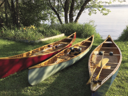

In [9]:
im = Image.open(dest)
im.to_thumb(128, 128)

## Choose a set of categories for the classification model

In [10]:
boat_types = 'canoe', 'kayak', 'sailboat'

In [11]:
path = Path('boats')

Download images from chosen categories. 

This cell may take a few minutes to run

In [12]:
if not path.exists():
    path.mkdir()
    for boat in boat_types:
        dest = (path/boat)
        dest.mkdir(exist_ok=True)
        results = search_images(boat)
        download_images(dest, urls=results)

In [13]:
!ls {path}
path

canoe  kayak  sailboat


Path('boats')

In [14]:
filenames = get_image_files(path)
filenames

(#554) [Path('boats/sailboat/3b873c96-0d1f-4404-9aae-af25d3805177.jpg'),Path('boats/sailboat/6336c57d-8ad9-4318-836c-fba58b5357be.jpg'),Path('boats/sailboat/d2a981d0-0d3e-4b0e-a077-a5cbda1a41b0.JPG'),Path('boats/sailboat/da7dc60e-7c83-4807-9fc1-a0f5061a5080.jpg'),Path('boats/sailboat/168643af-803b-4783-8c6b-a785157c481e.jpeg'),Path('boats/sailboat/f4055206-199c-42a8-bf74-8ed6c4dc7e08.jpg'),Path('boats/sailboat/d5883260-5325-41cb-a645-016051c37819.jpg'),Path('boats/sailboat/4b44e5d8-75e1-413b-a9b9-bd3f19b63df4.jpg'),Path('boats/sailboat/86d8f1b9-b75b-467f-8476-2d91805a150b.jpg'),Path('boats/sailboat/e07b4c1d-a717-4c10-9059-005016798081.jpeg')...]

#  Clean out any corrupt images from the dataset

In [15]:
failed = verify_images(filenames)

In [16]:
failed

(#0) []

In [17]:
failed.map(Path.unlink)

(#0) []

In [18]:
failed

(#0) []

## Some of the terminology in PyTorch fastai can be confusing. They can have similar names which mean very specific things. Here are some definintions
__Dataset__: an iterable over tuples containing images with their corresponding category. <br>
__Datasets__: a fastai class which joins together a training dataset and a validation dataset into one object.<br> 
__DataLoader__: a PyTorch iterable returning a batch of datasets.<br> 
__DataLoaders__: a fastai iterable which splits dataloaders into training and validation datasets. <br>
__batch__: The sample of the dataset loaded in parallel and passed to the model during one training loop. 

## Use the fastai DataBlock to create a way to load datasets and dataloaders


In [19]:
boats = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,
    splitter=RandomSplitter(valid_pct=0.2, seed=42),
    get_y=parent_label,
    item_tfms=Resize(128)
)

In [ ]:
dataloaders = boats.dataloaders(path)

The dataloaders object provides a way of loading batches of data from a location. It contains specific details on how the data should be transformed, how big a validation set to make, and a bunch of helper functions such as show.batch() which allow quick visualization and troubleshooting. 

## Training and validation sets

Our data is split into training and validation sets. 20% of the data is in the validation set, and 80% is in the training set. 

Here we can see a sample of one batch from the training set. The input feature is an image of a boat, and the target label is the class of the boat. There are three classes: canoe, sailboat and kayak. We can see using the show_batch function that the images and labels are all loaded and re-sized correctly.

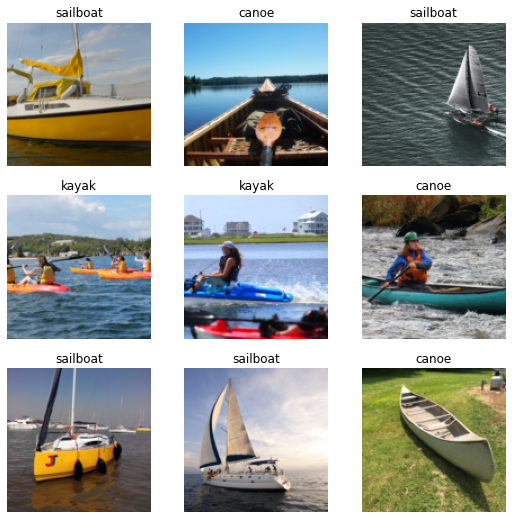

In [23]:
dataloaders.train.show_batch()

# Item transformations to reduce over-fitting. 
We only downloaded 200 images for each type of boat. We'll have to iterate over each image more than once in order for the model to see enough examples of each boat to bne able to train. It would be beneficial to have more images, or the model might just learn the specific form of each image in the dataset, and become over-confident and not be able to generalize to other images outside of the training set. This process is known as over-fitting.

We can transform the images in the training set each time they are loaded, reducing the risk of over-fitting.

Item transformations are one way we can reduce the amount of data required to train a machine learning model. 

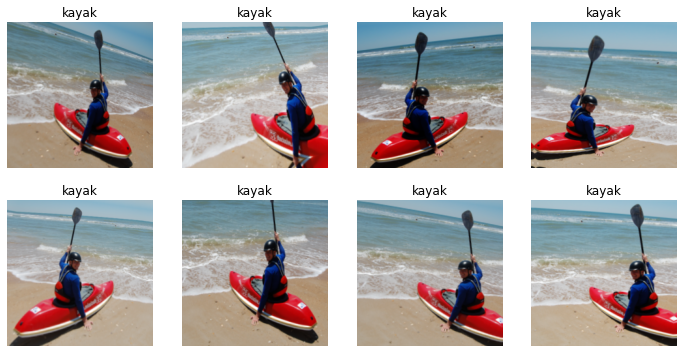

In [24]:
boats = boats.new(RandomResizedCrop(224, min_scale=0.5), 
                  batch_tfms=aug_transforms())
dataloaders = boats.dataloaders(path)
dataloaders.train.show_batch(max_n=8, nrows=2, unique=True)

# Train a model
## Pre-trained models.

Here we take a pre-trained image recognition model and fine tune it to learn the classes in our dataset. This resnet18 model was originally trained on the ImageNet dataset to recognize over 20,000 classes, with hundreds of examples in each class. We can take advantage of the large amount of work which went into training this model. 

Under the hood fastai replaces the output layers of the pre-trained model with randomly initialized layers with the same number of output nodes as the number of classes we're trying to predict (three: 'canoe', 'kakak', 'sailboat'). When we re-train the model, most of the work goes into training these final layers of the network, until the model learns to represent the categories we're looking for. This works even when the category we're looking for wasn't seen by the pre-trained model's original dataset. 

The earlier layers of a neural network tend to learn things like gradients, edges, colour, and the semantic meaning increases in deeper layers until the final layer represents the concept level output: canoe, kayak, sailboat. These earlier layers are useful for picking out features in a broad set of images - not just the ones the model was trained on. 

## Metrics
Metrics are a human readable representation of the performance of our model. Error rate is a pretty simple and easy to understand metric: what portion of the examples from the validation set did we mis-classify.

## Loss
Loss can be thought of as a sort of punishment function. The training process seeks to minimize loss, and the gradient of the loss function is used to calculate a better set of parameters during model training. The loss function can be thought of as a kind of error measure, but it is designed to be read by a machine, not a human, and to have smooth gradients. Lower loss usually means a better model. When plotting loss per epoch, decreasing loss curves are a good sign which mean the model is improving. If the loss curves are noisy or increasing, it is an indicator that we might have picked too high a learning rate, or that the model is beginnign to over-fit. 

Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth


  0%|          | 0.00/44.7M [00:00<?, ?B/s]

epoch,train_loss,valid_loss,error_rate,time
0,1.571849,0.666472,0.163636,00:14


epoch,train_loss,valid_loss,error_rate,time
0,0.534734,0.270972,0.118182,00:15
1,0.436475,0.234348,0.081818,00:15
2,0.353536,0.214399,0.063636,00:15
3,0.313201,0.206994,0.063636,00:14


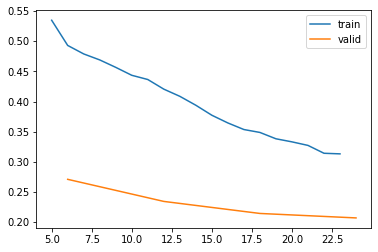

In [ ]:
learn = vision_learner(dataloaders, resnet18, metrics=error_rate)
learn.fine_tune(4)
learn.recorder.plot_loss()

# Confusion matrix
This confusion matrix shows us which categories we're getting most mixed up. It looks as though the canoe and the kayak class are most commonly confused, but the sailboats are less commonly mistaken. 

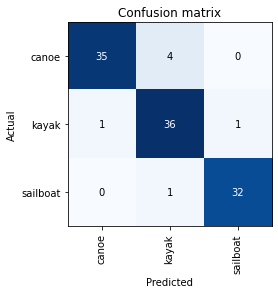

In [26]:
interpreter = ClassificationInterpretation.from_learner(learn)
interpreter.plot_confusion_matrix()

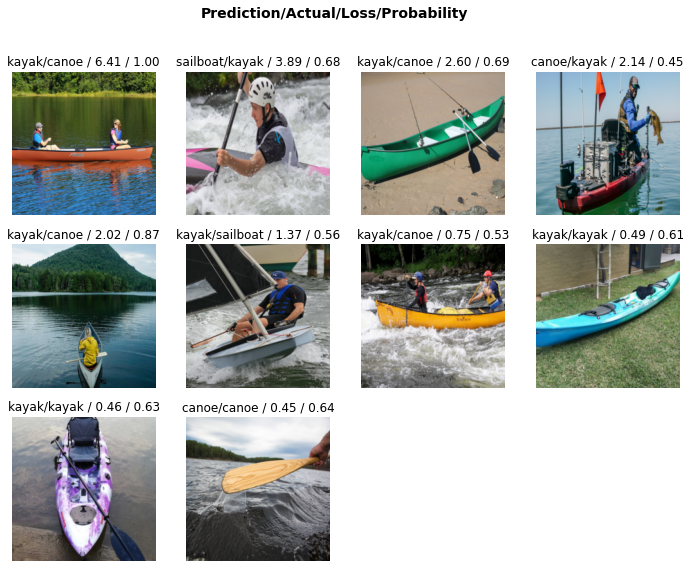

In [27]:
interpreter.plot_top_losses(10)

# Data cleaning
We can create a view of the images which had the highest loss values after training. A high loss would occur for an image which is very confidently wrongly identified, or one which is correctly identified but given a low probability. 


Sometimes the data we're training contains unusual examples. In the above images, there's an image of a wooden paddle, which is labelled canoe. This was labeled correctly, but the model was un-confident about the prediction, and so it shows up in our list of top losses. We can remove this image from the training set to create a more consistent set of training data, and hopefully a more accurate boat recognizer. 

In [28]:
cleaner = ImageClassifierCleaner(learn)
cleaner

In [29]:
# Delete bad images
for idx in cleaner.delete(): 
    cleaner.fns[idx].unlink()
    
# Recategorize mislabelled images
for idx, cat in cleaner.change():
    shutil.move(str(cleaner.fns[idx]), path/cat)

# Re train model with better data

SuggestedLRs(valley=9.120108734350652e-05)

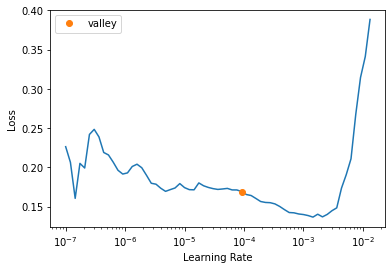

In [30]:
learn.lr_find()

epoch,train_loss,valid_loss,error_rate,time
0,1.453485,0.536477,0.163636,00:14


epoch,train_loss,valid_loss,error_rate,time
0,0.523266,0.295558,0.100000,00:15
1,0.439696,0.288609,0.090909,00:15
2,0.405357,0.218177,0.063636,00:14
3,0.350951,0.202666,0.063636,00:14


CPU times: user 10.2 s, sys: 8.59 s, total: 18.8 s
Wall time: 1min 14s


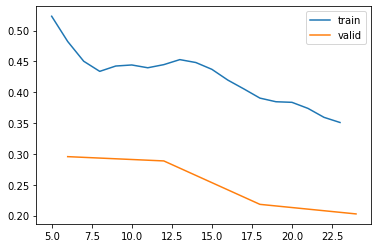

In [31]:
learn = vision_learner(dataloaders, resnet18, metrics=error_rate, lr=1e-4)
%time learn.fine_tune(4)
learn.recorder.plot_loss()

# Still improving - let's train some more

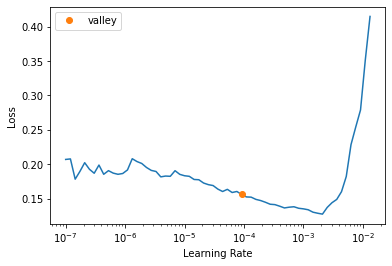

In [32]:
lr = learn.lr_find()

In [33]:
learn.fit_one_cycle(4, lr_max=lr)

epoch,train_loss,valid_loss,error_rate,time
0,0.171525,0.204587,0.063636,00:15
1,0.143939,0.204017,0.054545,00:14
2,0.135632,0.191662,0.045455,00:13
3,0.125083,0.184999,0.045455,00:13


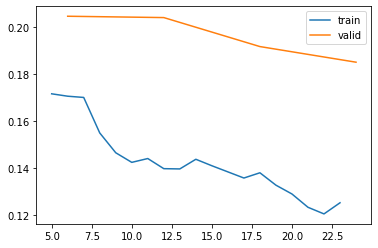

In [34]:
learn.recorder.plot_loss()

# Confusion matrix 2

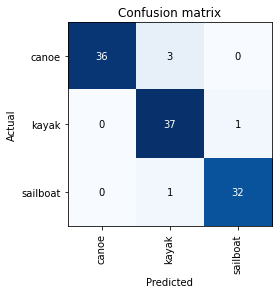

In [35]:
interpreter = ClassificationInterpretation.from_learner(learn)
interpreter.plot_confusion_matrix()

# Try using progressive resizing to speed up training.
We can create a custom dls which takes smaller images initially, then re-train on larger images. This speeds up training and improves performance in some cases, but it can reduce performance if the training images are similar to the ones the model was pre-trained on. 

In [36]:
def get_dls(bs, size):
    dblock = DataBlock(blocks=(ImageBlock, CategoryBlock),
                   get_items=get_image_files,
                   get_y=parent_label,
                   splitter=RandomSplitter(valid_pct=0.2, seed=42),
                   item_tfms=Resize(256),
                   batch_tfms=[*aug_transforms(size=size, min_scale=0.75),
                              Normalize.from_stats(*imagenet_stats)])
    return dblock.dataloaders(path, bs=bs)

dls = get_dls(64, 64)
learn_pr = Learner(dls, resnet18(pretrained=True), metrics=error_rate)
%time learn_pr.fit_one_cycle(4, 3e-3)

epoch,train_loss,valid_loss,error_rate,time
0,8.916942,23.666075,0.463636,00:15
1,4.849486,160.868179,0.609091,00:13
2,3.327196,12.700367,0.436364,00:15
3,2.517933,1.864578,0.336364,00:14


CPU times: user 3.08 s, sys: 5.22 s, total: 8.3 s
Wall time: 59.8 s


In [37]:
dls = get_dls(64, 256)
%time learn_pr.fine_tune(4, 3e-3)

epoch,train_loss,valid_loss,error_rate,time
0,0.876890,13.187647,0.354545,00:14


epoch,train_loss,valid_loss,error_rate,time
0,0.778222,0.704825,0.309091,00:14
1,0.635141,4.023889,0.372727,00:16
2,0.539282,11.316115,0.445455,00:14
3,0.529068,2.485397,0.381818,00:15


CPU times: user 3.98 s, sys: 6.35 s, total: 10.3 s
Wall time: 1min 16s


# Progressive resizing seems to reduce the model's performance
This could be because the images used to pre-train the resnet model are already similar to the images in our training set. By first training on low resolution images, we're altering the pretrained weights so that they are good at recognizing low resolution images, then when we pass the high res ones back in we're training the model to recognise high res images again. The training of the model to recognize high res (224*224) images has already been done for the pretrained model. 

It could be worth trying this approach for problems which don't use pretrained weights, or where the training data is different to the pretrained model's data.

# Using the model to predict on unseen data.
Here I test the model on some unseen images.

In [38]:
!ls images

canoe.jpg      testboat2.JPG  testboat5.JPG  testboat8.JPG
leaves.jpg     testboat3.JPG  testboat6.JPG  testboat9.JPG
testboat1.JPG  testboat4.JPG  testboat7.JPG


The model predicted sailboat with a confidence of 0.9949540495872498


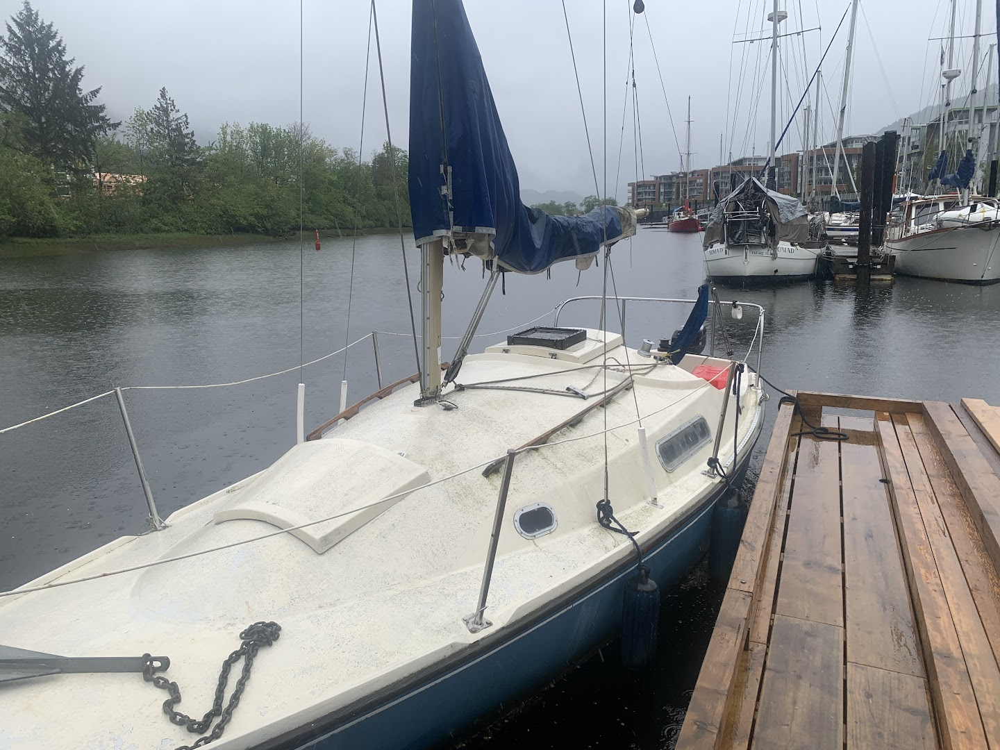

In [39]:
prediction, index, probs = learn.predict('images/testboat1.JPG')
print(f"The model predicted {prediction} with a confidence of {probs[index]}")
Image.open('images/testboat1.JPG')


# That looks pretty good. Let's try some more images

The model predicted canoe with a confidence of 0.8784130215644836
TensorBase([0.8784, 0.0732, 0.0484])


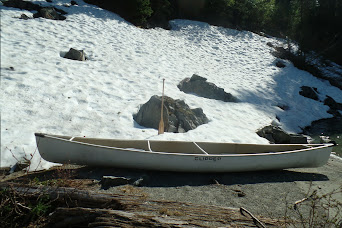

In [ ]:
prediction, index, probs = learn.predict('images/testboat2.JPG')
print(f"The model predicted {prediction} with a confidence of {probs[index]}")
print(probs)
Image.open('images/testboat2.JPG')

## Great, again we got a sensible preciction of 88% probability of a canoe.

The model predicted canoe with a confidence of 0.5352954268455505
TensorBase([0.5353, 0.1248, 0.3399])


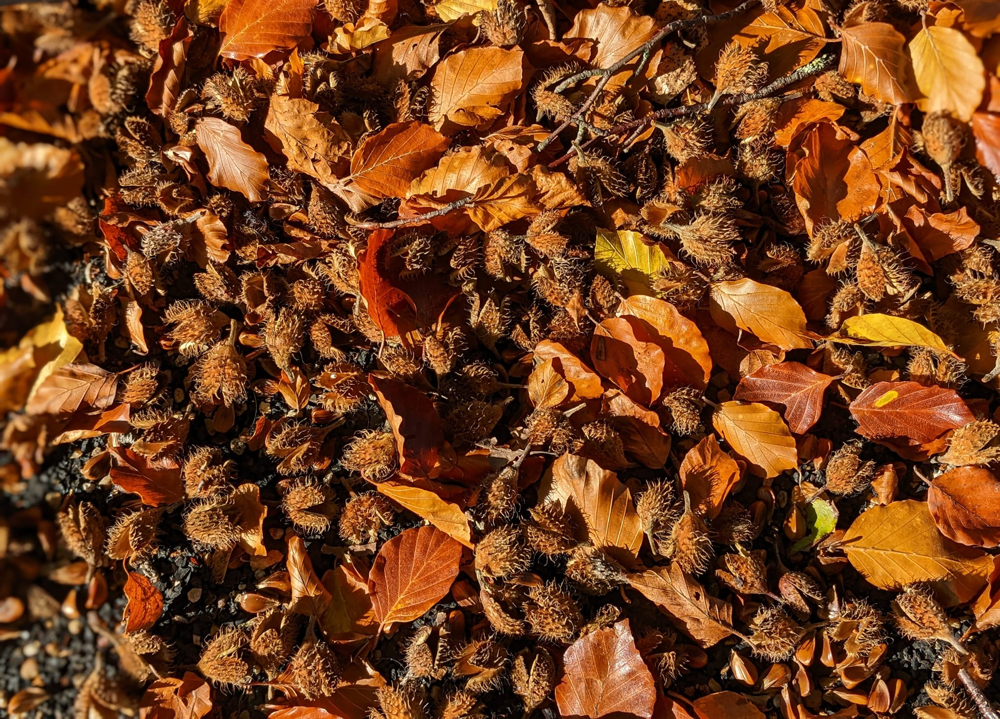

In [41]:
prediction, index, probs = learn.predict('images/leaves.jpg')
print(f"The model predicted {prediction} with a confidence of {probs[index]}")
print(probs)
Image.open('images/leaves.jpg')

# This result doesn't make sense!

Why is this happening?

Our model was trained using __Cross Entropy loss__ as the loss function. Because the cross entropy loss function uses __softmax__ as part of the calculation, it artificially drives output activations which are slightly higher than the others to be much closer to 1 in the output layer. This is great if we really want to identify one category out of all the optional categories, but it renders the model useless for predictions on images from a category which wasn't present in the training data, or in cases where there are more than one category present in an image.

# softmax function

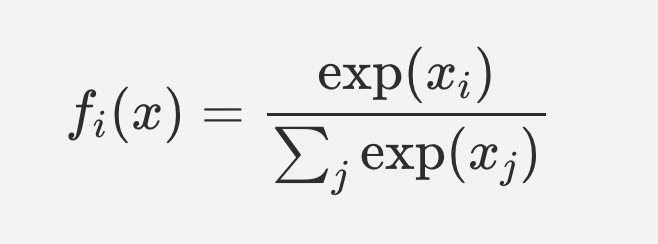

The __softmax__ function takes the exponent of each output activation in turn, and divides it by the sum of the exponents of all the output activations. In this way small differences between the larger activations get amplified more than the same differences between smaller activations. 

This mathematical trick is useful since it makes all the outputs activations sum to 1; a feature which is essential for cross-entropy loss to work. 


Example

In [42]:
activations = torch.tensor([0.1, 0.11, 0.34, 0.35])
sum(activations)

tensor(0.9000)

In [50]:
sm = activations.softmax(0)
sm

tensor([0.2190, 0.2212, 0.2785, 0.2813])

In [44]:
sm[0] - sm[1], sm[2] - sm[3]

(tensor(-0.0022), tensor(-0.0028))

The difference between 0.10 and 0.11 is the same as the difference between 0.34 and 0.35, but the softmax function amplifies this difference for larger activations.

In [45]:
sum(activations.softmax(0))

tensor(1.0000)

The outputs of the softmax function sum to 1, which is required for cross entropy loss to work. 

# Cross entopy loss is softmax combined with log likelihood.
Let's prove this by taking the negative log of the softmax of our activations:

In [46]:
-np.log(sm)

tensor([1.5185, 1.5085, 1.2785, 1.2685])

Now let's create a vector of targets to specify that the target activation is the fourth activation in our example:

In [47]:
targets = torch.tensor([0.0, 0.0, 0.0, 1.0])

Let's compare the value calculated by pytorch's nn.CrossEntropyLoss() function and the loss we calculated above. We'll assume that the item at index 3 was the target.

In [49]:
nn.CrossEntropyLoss()(activations, targets)

tensor(1.2685)

__negative log softmax of the activation at the target index is 1.2685. This is the same value we get when we take the cross entropy loss of the activations, which demonstrates their equivalence.__



# How does all this affect the training process?

When traing a model, the optimizer changes the parameters to minimize the loss. To make the loss approach zero, the model would have to drive the output activation at the target node increasingly higher, and drive the activations of the other nodes closer to zero. This results in efficient model training, but it also means that the model is never 'good enough'. The targets which the activations are compared against are numerically 1.0 or zero, but the output of the softmax function can never reach these lower and upper bounds. Training for longer will drive the model's output activations ever higher and higher in an effort to get closer to this mathematical impossibility. 


To illustrate this in one more way, in these examples, neither of the two sets of activations (1, 0) nor (10, 0 ) have a value equal to either 1 or 0 when passed through the softmax function. 

In [51]:
output_activation_1 = 1.0
output_activation_2 = 0.0
torch.tensor([output_activation_1, output_activation_2]).softmax(0)

tensor([0.7311, 0.2689])

In [52]:
output_activation_1 = 10.0
output_activation_2 = 0.0
torch.tensor([output_activation_1, output_activation_2]).softmax(0)

tensor([9.9995e-01, 4.5398e-05])


There's no amount of training which will cause the output of the softmax activations to equal zero or 1. 

The result of driving the activations within a network ever higher and higher can be networks which predict over confidently.

This is partly why we see the model confidently predicting that the image of a sailboat is actually a centipede.

It also makes it tricky to compare activations: all of the activations are on a different scale due to the amplification of higher values by the softmax function.

How can we do things differently?

# Binary crossentropy loss
If we wanted to be able to indicate uncertainty, and relative confidence between activations, we'd need to use a loss function which doesn't magnify small differences between the highest activations. All the activations values need to lie on the same scale as one another so we can make a direct comparison between them. Then we could set a threshold to choose whether we have a positive ID of that category. 

One way to do this is by treating each output activation separately as a binary classifier, then using crossentropy loss on each of the output activations separately rather than all together. 

## First we need to create a function to get the label
We already have this, in the form of parent_label(), which returns a string version of the parent folder containing the image. However, we're also going to tell fastai that the labels are multi-category labels, even though they're not. The multi-category block expects a list of strings as input - so if we just pass in a string then that will get split into a list of characters - not what we want. 

I'm doing this so that the labels are converted to one hot encoded vectors, which will allow us to use binary cross-entropy loss. 

Specifying the target type as 'MultiCategoryBlock' in the fastai DataBlock will create a model which can handle multiple classes in a single image. Rather than strongly picking one class out of many, we'll be choosing potentially many classes out of many. This has the beneficial side effect that we can threshold the output activations and create a 'no class recognized' output - an ability we don't have when using cross-entropy loss across all the activations.

In [53]:
def get_y(r): return parent_label(r).split(' ')

In [54]:
def accuracy_multi(inp, targ, thresh=0.5, sigmoid=True):
    "Compute accuracy when `inp` and `targ` are the same size."
    if sigmoid: inp = inp.sigmoid()
    return ((inp>thresh)==targ.bool()).float().mean()

In [72]:
boat_dls = DataBlock(
    blocks=(ImageBlock, MultiCategoryBlock),
    get_items=get_image_files,
    splitter=RandomSplitter(valid_pct=0.2, seed=42),
    get_y=get_y,
    item_tfms=Resize(128),
    batch_tfms=aug_transforms()
).dataloaders(path)

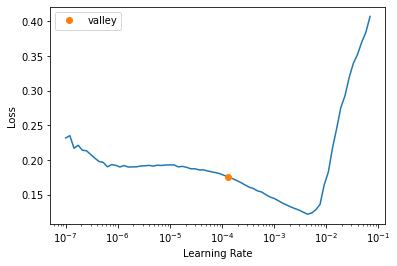

In [75]:
lr = learn.lr_find()

In [76]:
learn = vision_learner(boat_dls, resnet18, pretrained=True, metrics=accuracy_multi)
%time learn.fine_tune(6, base_lr=lr[0])

epoch,train_loss,valid_loss,accuracy_multi,time
0,1.020967,0.877902,0.563636,00:13


epoch,train_loss,valid_loss,accuracy_multi,time
0,0.947158,0.818463,0.545455,00:14
1,0.937178,0.750471,0.572727,00:13
2,0.897594,0.689925,0.627273,00:14
3,0.863008,0.640909,0.654545,00:14
4,0.827849,0.622816,0.663636,00:13
5,0.808169,0.619115,0.660606,00:14


# Using 16 bit floating point type
We can run this model using 16 bit numbers, which speeds up training and adds some granularity to the loss surface, which can help the model to generalize better. 

In [86]:
from fastai.callback.fp16 import *
learn = vision_learner(boat_dls, resnet18, pretrained=True, metrics=accuracy_multi).to_fp16()
%time learn.fine_tune(6, base_lr=lr[0])

epoch,train_loss,valid_loss,accuracy_multi,time
0,1.086145,0.876154,0.563636,00:13


epoch,train_loss,valid_loss,accuracy_multi,time
0,1.105501,0.791514,0.569697,00:12
1,1.058075,0.716644,0.581818,00:13
2,1.002346,0.651663,0.645455,00:13
3,0.962127,0.624689,0.666667,00:13
4,0.928638,0.611212,0.675758,00:14
5,0.899602,0.611228,0.678788,00:12


CPU times: user 6.25 s, sys: 9.32 s, total: 15.6 s
Wall time: 1min 32s


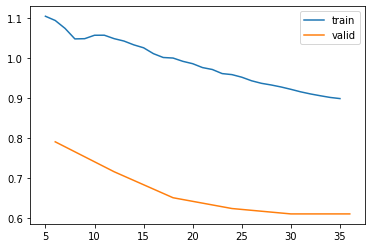

In [87]:
learn.recorder.plot_loss()

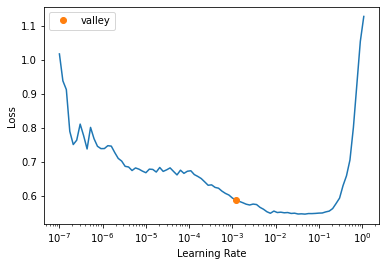

In [90]:
lr = learn.lr_find()

In [93]:
learn.fit_one_cycle(8, lr_max=slice(lr[0]/100, lr[0]))

epoch,train_loss,valid_loss,accuracy_multi,time
0,0.607456,62.795040,0.587879,00:14
1,0.513998,2.135366,0.706061,00:13
2,0.459160,9.297318,0.687879,00:13
3,0.420412,2.213437,0.757576,00:13
4,0.383483,0.640557,0.839394,00:14
5,0.348396,0.385552,0.848485,00:13
6,0.317297,0.342170,0.869697,00:12
7,0.295537,0.346389,0.872727,00:13


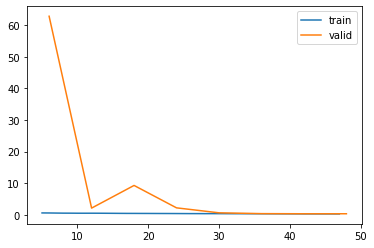

In [94]:
learn.recorder.plot_loss()

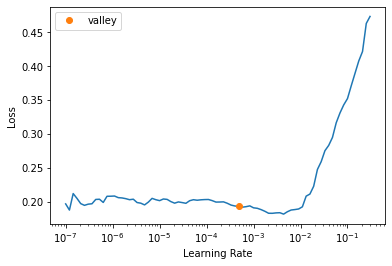

In [95]:
lr = learn.lr_find()

In [96]:
learn.fit_one_cycle(8, lr_max=slice(lr[0]/100, lr[0]))

epoch,train_loss,valid_loss,accuracy_multi,time
0,0.253123,0.341837,0.866667,00:16
1,0.218674,0.335589,0.869697,00:13
2,0.210459,0.330646,0.866667,00:14
3,0.208750,0.342269,0.869697,00:14
4,0.208109,0.342271,0.869697,00:14
5,0.209671,0.347175,0.869697,00:13
6,0.205469,0.337658,0.872727,00:14
7,0.198987,0.339411,0.872727,00:13


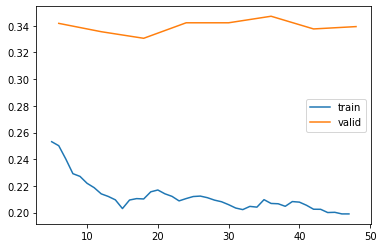

In [98]:
learn.recorder.plot_loss()

# We've reached 87% accuracy with our Binary Cross Entropy model.
This isn't as good as the 93% we achieved using Cross Entropy loss, but perhaps we can adjust the classification threshold in order to allow fewer false positives or false negatives. 

Remember our model is outputting a vector of activations. We're currently picking an arbitrary classification threshold of 0.5.

In [106]:
x,y = dls.one_batch()
learn.model(x)[:5]

TensorBase([[ 1.0367, -1.7452, -3.1625],
            [ 3.0763, -1.6344, -6.4808],
            [ 0.2218,  0.5060, -6.9259],
            [-0.8240,  1.0332, -5.1113],
            [-1.3156, -0.7857, -0.0276]], device='cuda:0',
           grad_fn=<AliasBackward0>)

In [110]:
learn.metrics = partial(accuracy_multi, thresh=0.1)
val_loss, val_accuracy = learn.validate()
val_loss, val_accuracy

(0.3394106328487396, 0.7969697713851929)

In [116]:
preds, targs = learn.get_preds()

By default, get_preds applies the output activation

In [124]:
preds.max()

TensorBase(1.)

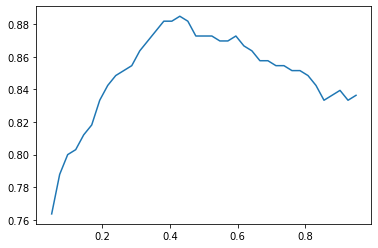

In [126]:
xs = torch.linspace(0.05, 0.95, 39)
accs = [accuracy_multi(preds, targs, thresh=i, sigmoid=False) for i in xs]
plt.plot(xs, accs)

We seem to be in the right ballpark with 0.5 as the threshold. Trying 0.4 instead might improve the accuracy a little.

# Now we can check whether the model makes more sensible predictions for unseen training items

The model predicted ['canoe', 'kayak', 'sailboat'] with a confidence of TensorBase([0.9508, 0.5829, 0.7437])


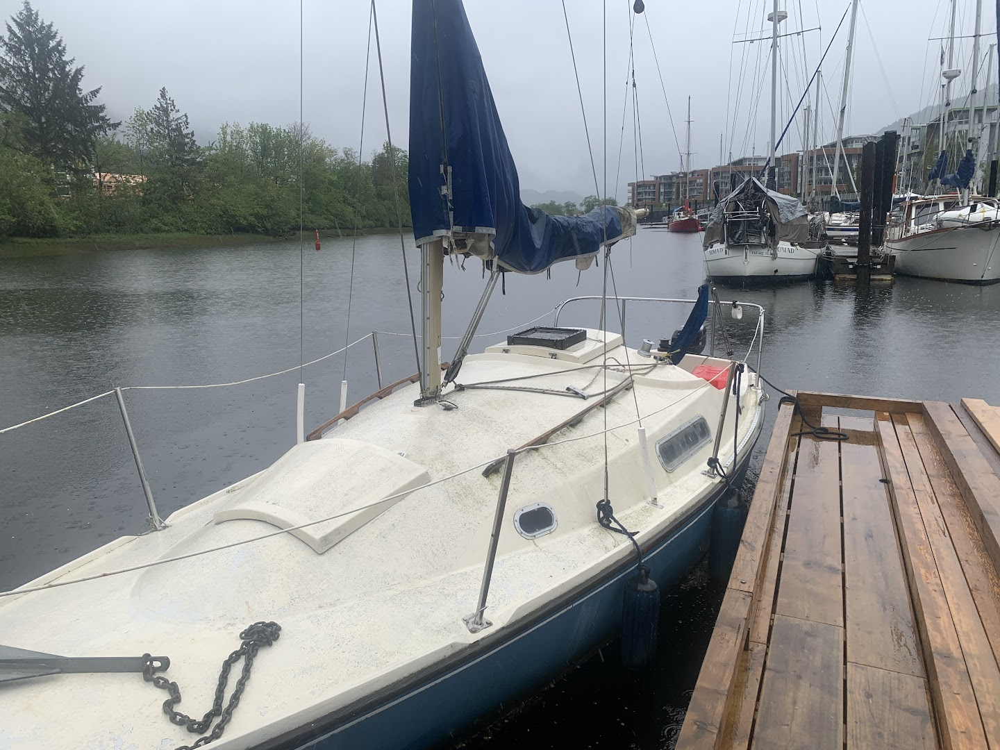

In [79]:
prediction, index, probs = learn.predict('images/testboat1.JPG')
print(f"The model predicted {prediction} with a confidence of {probs[index]}")
Image.open('images/testboat1.JPG')


# That looks pretty good. 
As expected, the model isn't as confident as when we used Crossentropy loss. 


Let's try some more images

The model predicted ['sailboat'] with a confidence of TensorBase([0.6927])
TensorBase([0.4364, 0.2219, 0.6927])


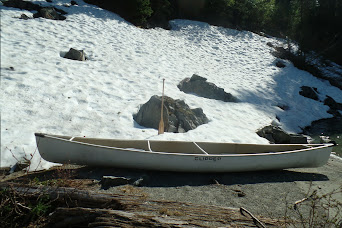

In [ ]:
prediction, index, probs = learn.predict('images/testboat2.JPG')
print(f"The model predicted {prediction} with a confidence of {probs[index]}")
print(probs)
Image.open('images/testboat2.JPG')

The model got this one wrong whereas before it identified it correctly. Perhaps the model needs to train for longer when we use this approach. It doesn't have the same speed of convergence as the first method. 

The model predicted [] with a confidence of TensorBase([])
TensorBase([0.2653, 0.2071, 0.0991])


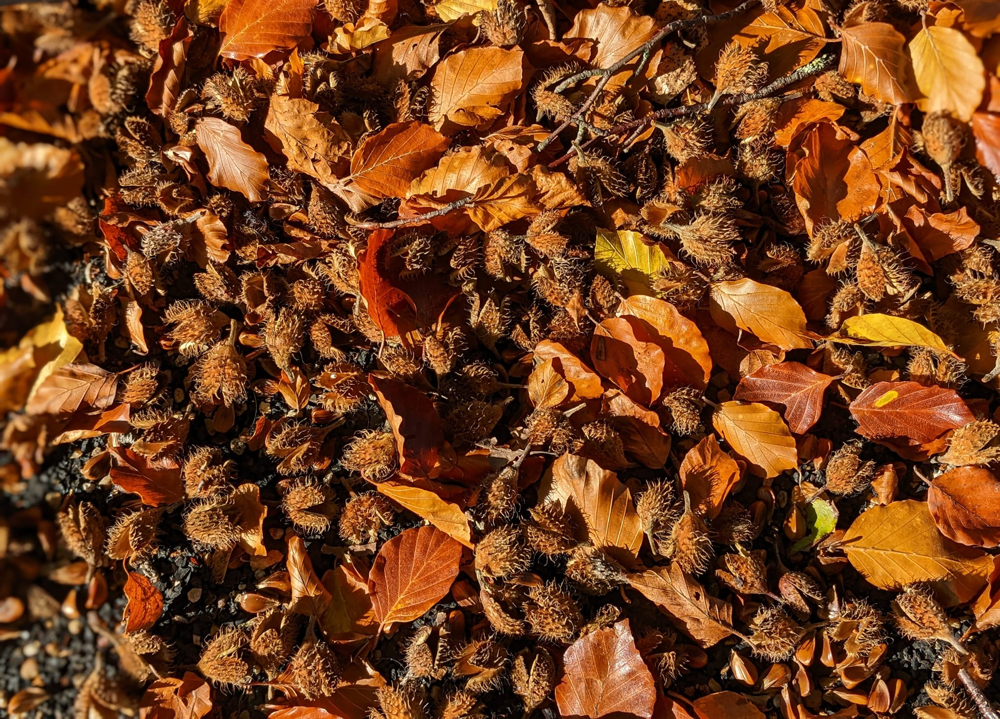

In [81]:
prediction, index, probs = learn.predict('images/leaves.jpg')
print(f"The model predicted {prediction} with a confidence of {probs[index]}")
print(probs)
Image.open('images/leaves.jpg')


# No-class predicted: Our image recognition model using binary crossentropy works!
In this final example the model predicted a low score for each of the classes, rather than returning an artificially high probability like when we used cross-entropy loss. The model predicted 'no class'!

# Here's a summary of the resnet 18 model architecture. 

In [60]:
learn.summary()

Sequential (Input shape: 64 x 3 x 128 x 128)
Layer (type)         Output Shape         Param #    Trainable 
                     64 x 64 x 64 x 64   
Conv2d                                    9408       True      
BatchNorm2d                               128        True      
ReLU                                                           
____________________________________________________________________________
                     64 x 64 x 32 x 32   
MaxPool2d                                                      
Conv2d                                    36864      True      
BatchNorm2d                               128        True      
ReLU                                                           
Conv2d                                    36864      True      
BatchNorm2d                               128        True      
Conv2d                                    36864      True      
BatchNorm2d                               128        True      
ReLU                      

# Conclusion 
- Many of the components for creating image recognition models is made easy with fastai. 
- Using cross-entropy loss results in faster, more efficient training for single class classifier models. 
- Cross-entropy loss can cause a model to drive its internal activations ever higher. This can produce an over-confident model. 
- Using Binary-Crossentropy loss on each output activation with a one hot encoded vector of targets doesn't train as quickly as regular crossentropy loss, but it does give us the option to classify multiple classes in one example, and to set a threshold below which we don't make a positive ID. 

# Thanks for reading :)